In [7]:
import warnings
warnings.filterwarnings("ignore")
import  matplotlib.pyplot as plt 
import pandas as pd 
import numpy as np 

dataset = pd.read_csv('../data/PrionData.csv')
print(dataset.head())


Unnamed: 0      mass    weight prion_status
0           1  0.828588  0.015244    non-prion
1           2  0.624495  0.605444        prion
2           3  0.246620  0.691141    non-prion
3           4  0.879880  0.023820    non-prion
4           5  0.414403  0.562968    non-prion


In [8]:
#droping unwanted data
dataset = dataset.drop(['Unnamed: 0'],axis=1)
print(dataset.head())
print (len(dataset))

mass    weight prion_status
0  0.828588  0.015244    non-prion
1  0.624495  0.605444        prion
2  0.246620  0.691141    non-prion
3  0.879880  0.023820    non-prion
4  0.414403  0.562968    non-prion
485


(485, 3)


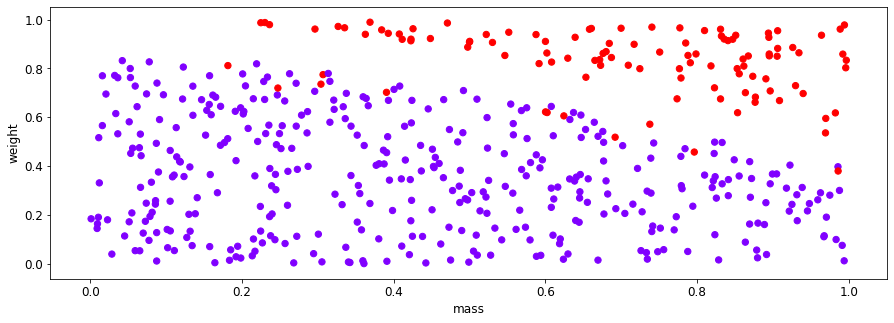

In [21]:
#view data
X = dataset['mass']
Y = dataset['weight']
target = (dataset['prion_status'] == 'prion')
print (dataset.shape)
plt.scatter(X,Y,c=target,zorder = 10 ,s = 40 )
plt.xlabel('mass')
plt.ylabel('weight')
plt.show()

In [10]:
#diving the data into training and test set
train_X = dataset.drop(['prion_status'],1).truncate(after= 399)
train_Y = dataset['prion_status'].truncate(after= 399)
#print (train_X.head())
test_X = dataset.drop(['prion_status'],1).truncate(before = 400).reset_index(drop = True)
test_Y = dataset['prion_status'].truncate(before = 400).reset_index(drop = True)
#print(train_X.describe())
#print(test_Y.describe())

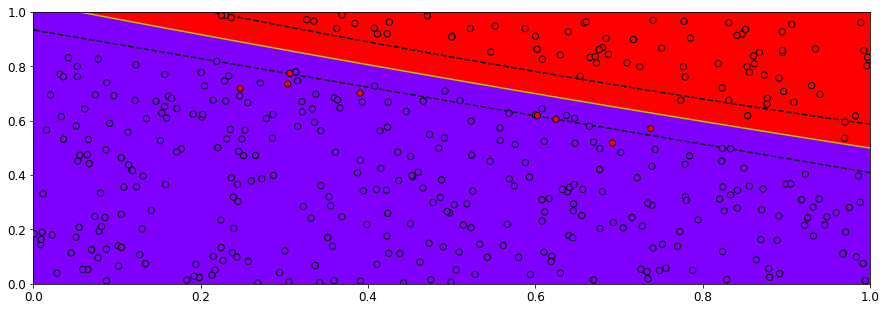

In [22]:
from sklearn import svm 
model = svm.SVC(gamma='auto').fit(train_X,train_Y)


def plot_SVM(clf,data,target):
    is_prion = target == 'prion'
    plt.scatter(data['mass'],data['weight'],c = is_prion,zorder = 10 , edgecolor = 'k' , s = 40)
    XX,YY = np.mgrid[0:1:255j, 0:1:255j]
    z = clf.decision_function(np.c_[XX.ravel(),YY.ravel()]).reshape(XX.shape)
    plt.rcParams['figure.figsize'] = (15,5)
    plt.rcParams['font.family'] = 'DejaVu Sans'
    plt.rcParams['font.size'] = '12'
    #plt.rcParams['image.cmap'] = 'rainbow'
    plt.pcolormesh(XX,YY, z > 0)
    plt.contour(XX,YY,z,colors = ['k','y','k'], linestyles = ['--','-','--'],levels = [-0.5, 0 , 0.5])
    plt.ylim(0,1)
    plt.xlim(0,1)
    plt.show()

plot_SVM(model,train_X,train_Y)

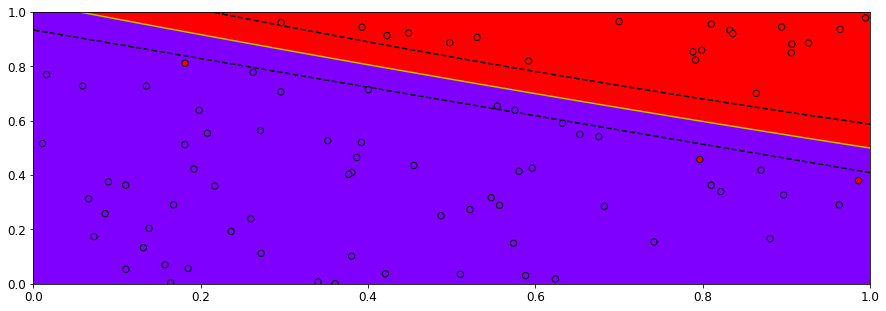

In [24]:
#test plot
plot_SVM(model, test_X, test_Y)

In [28]:
#evaluate with prediction 
train_Pred = model.predict(train_X.values)
test_Pred = model.predict(test_X.values)

def evaluate_model (pred , real , train_test) :
    matches = pred == real
    accuracy = sum(matches)/len(matches) * 100
    print (train_test , " Accuracy =   " , accuracy , "%")

evaluate_model(train_Pred, train_Y,"train data")
evaluate_model(test_Pred,test_Y, "test data")

train data  Accuracy =    97.75 %
test data  Accuracy =    96.47058823529412 %
